# Ingest data from data source to S3 bucket

***

## Libraries

In [68]:
import sagemaker
import boto3
from datetime import datetime
from io import StringIO
import pandas as pd
import numpy as np
from scipy import stats
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.tsa.stattools import acf, pacf
from sklearn.model_selection import train_test_split
from tqdm import tqdm
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.figure_factory as ff


## Variables

In [4]:
sess = sagemaker.Session() #Intialzie session

bucket = sess.default_bucket()
RD_Bucket = 'sdpd-bucket2' #Raw Data
role = sagemaker.get_execution_role()
region = boto3.Session().region_name
s3 = boto3.client('s3') # Create an S3 client
s3_resource = boto3.resource('s3') # Create an S3 resource

print('Bucket - > ',bucket)
print('Role - > ',role)
print('Region - > ',region)
print('S3 - > ',s3)
print('S3 Resource - > ',s3_resource)

Bucket - >  sagemaker-us-east-1-690585323461
Role - >  arn:aws:iam::690585323461:role/LabRole
Region - >  us-east-1
S3 - >  <botocore.client.S3 object at 0x7f3ab10b7a10>
S3 Resource - >  s3.ServiceResource()


## Prepare landing zone

In [15]:
# Function to verify if bucket exist, if not create
def verify_create_bucket(bucket_name):
    response = s3.list_buckets()
    for bucket in response['Buckets']:
        if bucket['Name'] == bucket_name:
            print(f"The {bucket_name} bucket exists.")
            break
    else:
        print(f"The {bucket_name} bucket does not exist, creating")
        !aws s3 mb s3://{RD_Bucket}/

In [16]:
verify_create_bucket(RD_Bucket)

The sdpd-bucket2 bucket does not exist, creating
make_bucket: sdpd-bucket2


## Download Files

***

### Load calls

In [5]:
#function to download yearly data
def Get_Data(year):
    url = f"https://seshat.datasd.org/pd/pd_calls_for_service_{year}_datasd.csv"
    df = pd.read_csv(url)
    return df

In [6]:
# List of years since 2018
Years = list(range(2018,datetime.now().year+1))
Years

[2018, 2019, 2020, 2021, 2022, 2023]

In [7]:
sdpd_calls = pd.DataFrame()
#iterate over years
for year in tqdm(Years):
    year_df = Get_Data(year)
    year_df['Year'] = year
    sdpd_calls = pd.concat((sdpd_calls, year_df))

100%|██████████| 6/6 [00:18<00:00,  3.16s/it]


In [8]:
#Verify Shape
sdpd_calls.shape

(2909257, 15)

In [9]:
sdpd_calls = sdpd_calls.drop(['address_dir_intersecting', 'address_sfx_intersecting'], axis=1)

***

In [10]:
type_url = f"http://seshat.datasd.org/pd/pd_cfs_calltypes_datasd.csv"
dipo_url = f"http://seshat.datasd.org/pd/pd_dispo_codes_datasd.csv"
ripa_stops_url = "https://seshat.datasd.org/pd/ripa_stops_datasd.csv"
ripa_stops_dic = "https://seshat.datasd.org/pd/ripa_stops_dictionary_datasd.csv"

In [11]:
def download_file(url):
    df = pd.read_csv(url, low_memory=False)
    return df

In [12]:
type_df = download_file(type_url)
dispo_df = download_file(dipo_url)
ripa_stops_df = download_file(ripa_stops_url)
ripa_stops_dic_df = download_file(ripa_stops_dic)


***

## Data Quality Report

In [25]:
def Data_Quality_Report(df):

    #Initial table
    freqDF = pd.DataFrame(columns=['Feature',
                                   'Mode',
                                   'Mode Freq.',
                                   'Mode %',
                                   '2nd Mode',
                                   '2nd Mode Freq.',
                                   '2nd Mode %'])
    for col in tqdm(df.columns):
        try:
            #print(col)
            freq = df[col].value_counts()
            freqdf = freq.to_frame()
            fRow = freqdf.iloc[0]
            #try:
            secRow = freqdf.iloc[1]
            #except:
            #secRow = 0
            fPrct = fRow[0] / len(df[col])
            #try:
            secPrct = secRow[0] / len(df[col])
            #except:
                #secPrct = 0
            try:
                mode1 = int(fRow.name)
            except:
                mode1 = fRow.name
            try:
                mode2 = int(secRow.name)
            except:
                try:
                    mode2 = secRow.name
                except:
                    mode2 = 0
            freqDF = freqDF.append({'Feature':col,
                                    'Mode':mode1,
                                    'Mode Freq.':fRow[0],
                                    'Mode %':fPrct,\
                                    '2nd Mode':mode2,
                                    '2nd Mode Freq.':secRow[0],
                                    '2nd Mode %':secPrct},
                                    ignore_index=True)
        except:
            pass

    freqDF = freqDF.set_index('Feature')

    #Nulls, Counts, Cardinality
    NUllFeatures = round(df.isnull().sum() / df.shape[0],4)\
          .sort_values(ascending=False)
    Count = df.count()
    uni = df.nunique()

    #Formating
    NUllFeatures.to_frame(name="% Miss.")
    Count.to_frame(name="Count")
    uni.to_frame()
    result = pd.concat([Count, NUllFeatures,uni], axis=1)
    result.columns =["Count","% Miss.","Card."]
    result = pd.concat([result, freqDF], axis=1)
    
    result = result.style.format({'% Miss.': "{:.1%}",
                         'Mode %': "{:.0%}",
                         '2nd Mode %': "{:.0%}",
                         'Count': "{:,}",
                         'Card.': "{:,}",
                         'Mode Freq.': "{:,}",
                        '2nd Mode Freq.': "{:,}"})
    return result

In [26]:
DQR_Calls = Data_Quality_Report(sdpd_calls)
DQR_Calls

100%|██████████| 13/13 [00:08<00:00,  1.55it/s]


,Count,% Miss.,Card.,Mode,Mode Freq.,Mode %,2nd Mode,2nd Mode Freq.,2nd Mode %
incident_num,"2,905,156",0.0%,"2,905,156",E22110036048,1,0%,E21060003751,1,0%
date_time,"2,905,156",0.0%,"2,877,729",2020-02-12 20:51:38,4,0%,2020-12-21 11:02:13,4,0%
day_of_week,"2,905,156",0.0%,8,3,"430,725",15%,4,"427,771",15%
address_number_primary,"2,905,156",0.0%,318,0,"532,340",18%,4000,"57,911",2%
address_dir_primary,"136,795",95.3%,12,W,"50,623",2%,S,"44,446",2%
address_road_primary,"2,904,593",0.0%,"18,131",IMPERIAL,"51,689",2%,UNIVERSITY,"46,879",2%
address_sfx_primary,"2,663,593",8.3%,48,ST,"875,701",30%,AVE,"694,590",24%
address_road_intersecting,"494,183",83.0%,"8,764",UNIVERSITY,"13,577",0%,IMPERIAL,"12,400",0%
call_type,"2,898,731",0.2%,282,415,"256,463",9%,T,"133,964",5%
disposition,"2,897,864",0.2%,24,K,"1,468,222",51%,O,"491,011",17%


In [27]:
DQR_Stops = Data_Quality_Report(ripa_stops_df)
DQR_Stops

100%|██████████| 29/29 [00:01<00:00, 24.15it/s]


,Count,% Miss.,Card.,Mode,Mode Freq.,Mode %,2nd Mode,2nd Mode Freq.,2nd Mode %
stop_id,"653,601",0.0%,"574,368",174011,52,0%,184085,48,0%
ori,"653,601",0.0%,1,nan,nan,nan%,nan,nan,nan%
agency,"653,601",0.0%,1,nan,nan,nan%,nan,nan,nan%
exp_years,"653,601",0.0%,41,1,"256,905",39%,3,"49,912",8%
date_stop,"653,601",0.0%,"1,645",2020-02-12,799,0%,2019-05-23,793,0%
time_stop,"653,601",0.0%,"83,477",16:00:00,"1,772",0%,10:00:00,"1,492",0%
stopduration,"653,601",0.0%,398,10,"157,652",24%,15,"77,367",12%
stop_in_response_to_cfs,"653,601",0.0%,2,0,"584,869",89%,1,"68,732",11%
officer_assignment_key,"653,601",0.0%,10,1,"610,968",93%,10,"20,167",3%
assignment,"653,601",0.0%,10,"Patrol, traffic enforcement, field operations","610,968",93%,Other,"20,167",3%


***

## Save Date to Buckets

In [13]:
def move_2_bucket(bucket,subfolder_name,file_name,df):
    csv_buffer = StringIO()
    df.to_csv(csv_buffer, index=False)
    s3_resource.Object(bucket,
                       subfolder_name + file_name).put(Body=csv_buffer.getvalue())
    print(file_name,'loaded in',bucket,'bucket')
    

In [57]:
move_2_bucket(RD_Bucket,'Call_Data/','SDPD_Calls.csv',sdpd_calls)
move_2_bucket(RD_Bucket,'Type_Data/','SDPD_Type.csv',type_df)
move_2_bucket(RD_Bucket,'Dispo_Data/','SDPD_Dispo.csv',dispo_df)
move_2_bucket(RD_Bucket,'Stops_Data/','SDPD_Stops.csv',ripa_stops_df)
move_2_bucket(RD_Bucket,'Stops_Dic_Data/','SDPD_Stops_Dic.csv',ripa_stops_dic_df)

SDPD_Calls.csv loaded in sdpd-bucket2 bucket
SDPD_Type.csv loaded in sdpd-bucket2 bucket
SDPD_Dispo.csv loaded in sdpd-bucket2 bucket
SDPD_Stops.csv loaded in sdpd-bucket2 bucket
SDPD_Stops_Dic.csv loaded in sdpd-bucket2 bucket


<div class="alert alert-block alert-success">
<b>Data:</b> Loaded in S3 Buckets
</div>

***

## Aggregate Police Activity by Hour

### Functions

In [15]:
def events_hour(df,freq,date_field,groupby):
    df[date_field]=pd.to_datetime(df[date_field])
    df_group = df.groupby([
        pd.Grouper(key=date_field,freq=freq),
        groupby
    ]).size().reset_index(name='count')
    
    return df_group

In [16]:
def events_timeseries(df,freq,date_field):
    df[date_field]=pd.to_datetime(df[date_field], utc=True)
    df_group = df.groupby([
        pd.Grouper(key=date_field,freq=freq)
    ]).size().reset_index(name='count')
    
    return df_group

In [17]:
def categorise(row):  
    if row['count'] > 0 and row['count'] <= 130000:
        return 'Low Quarter'
    elif row['count'] > 150000:
        return 'High Quarter'
    return 'Normal Quarter'

### Datasets

In [18]:
time_series_priority = events_hour(sdpd_calls,'H','date_time','priority')
time_series = events_timeseries(sdpd_calls,'M','date_time')
time_series_hr = events_timeseries(sdpd_calls,'H','date_time')
time_series_q = events_timeseries(sdpd_calls,'Q','date_time')

In [19]:
#Priority
time_series_priority['year'] = time_series_priority['date_time'].dt.year
time_series_prior_2023 = time_series_priority[time_series_priority.year == 2023]


#Monthly
time_series['year'] = time_series['date_time'].dt.year
time_series['month'] = time_series['date_time'].dt.month_name()
time_series_complete = time_series[time_series.year != 2023]

#Quarter
time_series_q['year'] = time_series_q['date_time'].dt.year
time_series_q['quarter'] = pd.PeriodIndex(time_series_q.date_time, freq='Q')
time_series_q['Quarter'] = pd.PeriodIndex(time_series_q['quarter'], freq='Q').strftime('%Y-%m')
time_series_q['Level'] = time_series_q.apply(lambda row: categorise(row), axis=1)
time_series_complete_q = time_series_q[time_series_q.year != 2023]

#Hourly
time_series_hr['year'] = time_series_hr['date_time'].dt.year
time_series_hr['hour'] = time_series_hr['date_time'].dt.hour
#time_series_hr = time_series_hr[time_series_hr.year != 2023]
time_series_hr_grby =time_series_hr.groupby(by=["hour","year"]).mean()



In [20]:
time_series_hr_grby = time_series_hr_grby.rename_axis(['hour', 'year']).reset_index()

In [21]:
time_series_hr_grby['hour'] = time_series_hr_grby['hour'].astype(str)

***

## Visualize

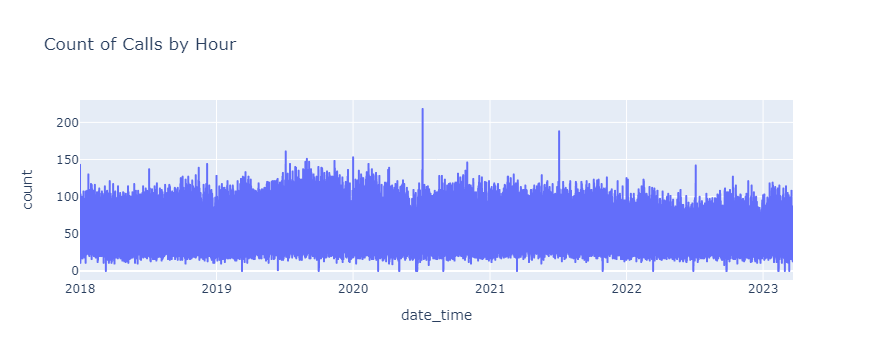

In [37]:
fig = px.line(time_series_hr,
             x='date_time',
             y="count",
             title="Count of Calls by Hour"
             )
fig.show()

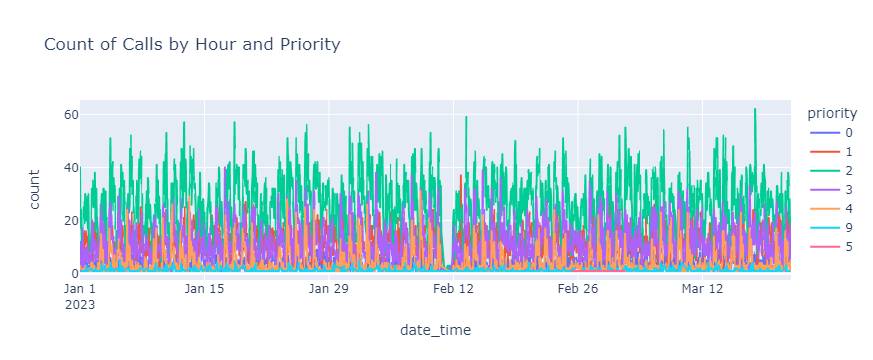

In [38]:
fig = px.line(time_series_prior_2023,
             x='date_time',
             y="count",
             title="Count of Calls by Hour and Priority",
            color='priority'
             )
fig.show()

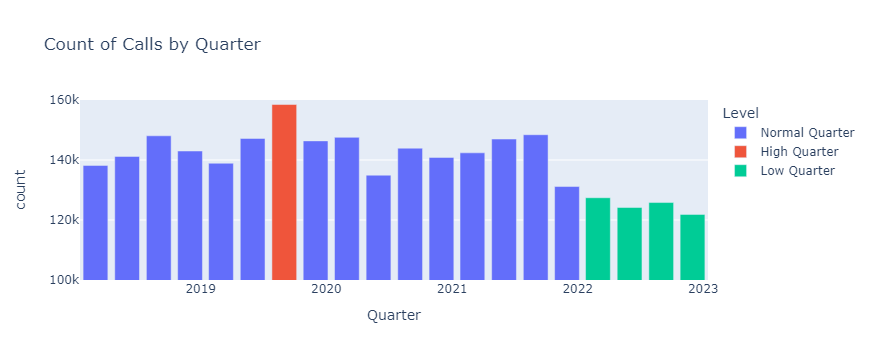

In [39]:
fig = px.bar(time_series_complete_q,
             x='Quarter',
             y="count",
             color='Level',
             #marker_color='Level',
             title="Count of Calls by Quarter"
            )
fig.update_layout(yaxis_range=[100000,160000])
fig.show()

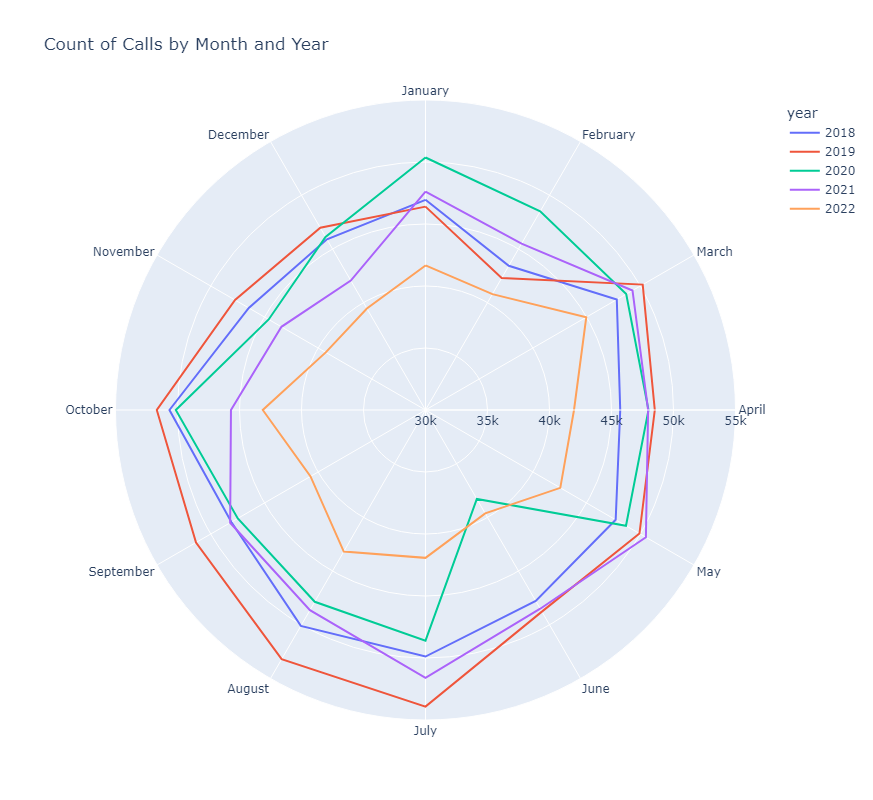

In [40]:
fig = px.line_polar(
    data_frame=time_series_complete, 
    r="count", 
    theta="month", 
    color="year",
    range_r=[30000,55000],
    line_close=True,
    #color_discrete_sequence=px.colors.sequential.Cividis,
    width=800,
    height=800,
    title="Count of Calls by Month and Year"
)
fig.show()

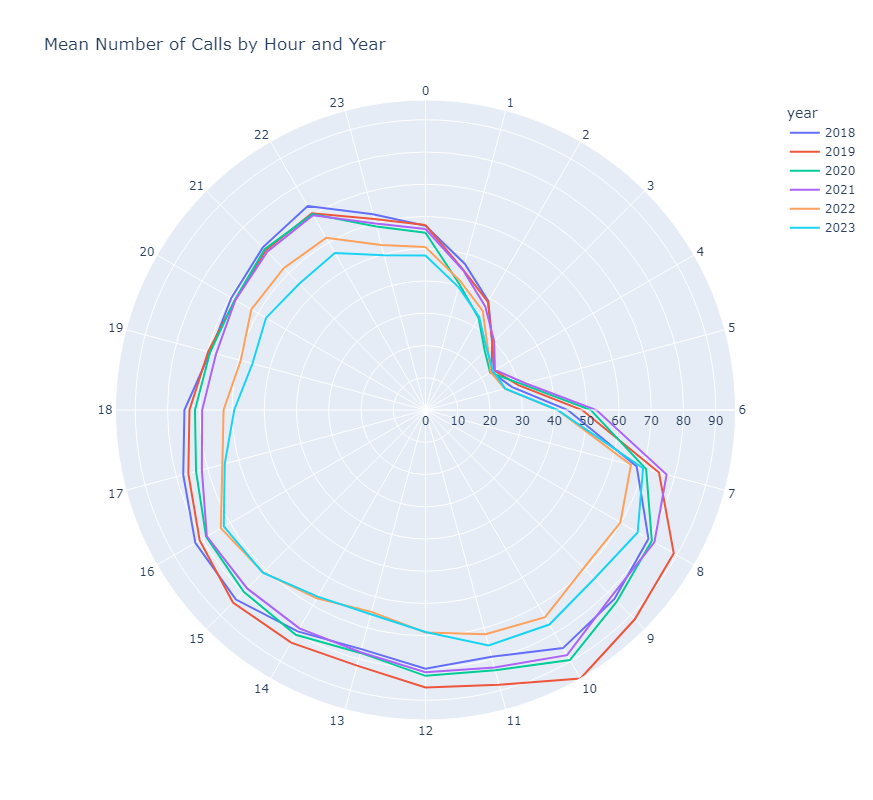

In [41]:
fig = px.line_polar(
    data_frame=time_series_hr_grby, 
    r="count", 
    theta="hour", 
    color="year",
    #range_r=[30000,55000],
    line_close=True,
    #color_discrete_sequence=px.colors.sequential.Cividis,
    width=800,
    height=800,
    title="Mean Number of Calls by Hour and Year"
)
fig.show()

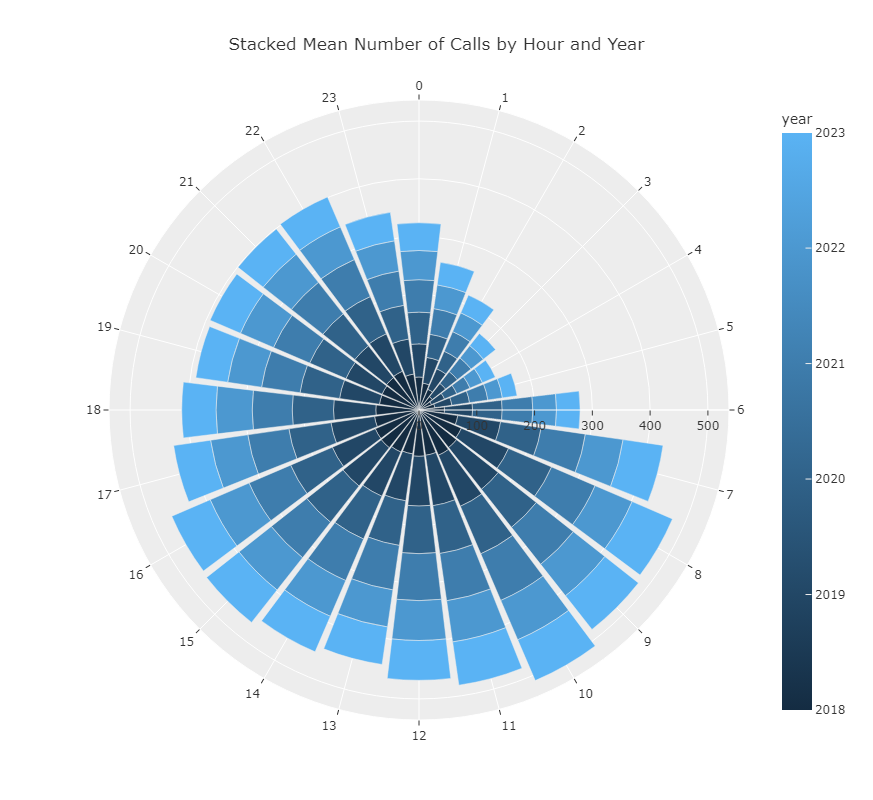

In [42]:
fig = px.bar_polar(
    data_frame=time_series_hr_grby, 
    r="count", 
    theta="hour", 
    color="year",
    #range_r=[30000,55000],
    #animation_frame = 'type_1',
    #color_discrete_sequence=px.colors.sequential.Cividis,
    width=800,
    height=800,
    title="Stacked Mean Number of Calls by Hour and Year",
    template = 'ggplot2'
)
fig.show()

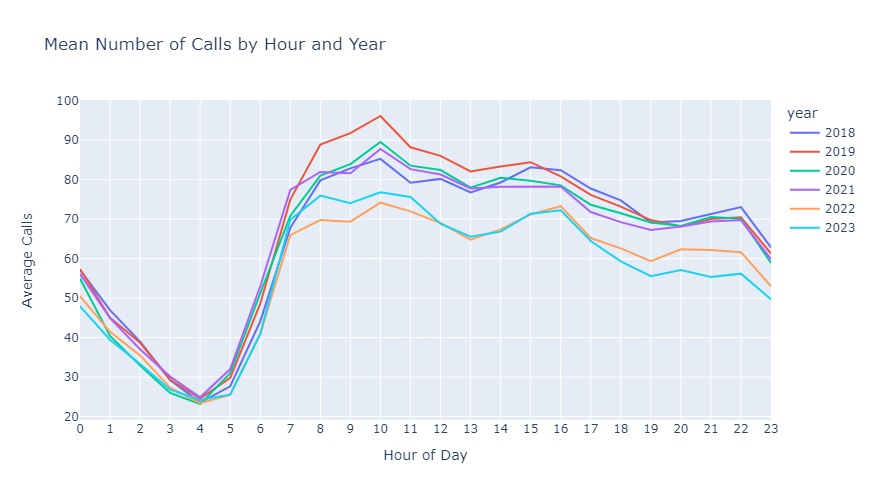

In [43]:
fig = px.line(time_series_hr_grby,
              x='hour',
              y="count",
              color='year',
              title="Mean Number of Calls by Hour and Year",
              width=1200,
              height=500,
              labels={
                     "hour": "Hour of Day",
                     "count": "Average Calls",
                 },
            )
#fig.update_layout(yaxis_range=[100000,160000])
fig.show()

# Data Preparation - Police Stop Data

In [58]:
ripa_stops_df.head()
#ripa_stops_df.dtypes

,stop_id,ori,agency,exp_years,date_stop,time_stop,stopduration,stop_in_response_to_cfs,officer_assignment_key,assignment,...,beat_name,pid,isstudent,perceived_limited_english,perceived_age,perceived_gender,gender_nonconforming,gend,gend_nc,perceived_lgbt
0,10000,CA0371100,SD,26,2018-07-15,19:31:37,5,0,1,"Patrol, traffic enforcement, field operations",...,Kearney Mesa 313,1,0,0,50,Male,0,1,NaN,No
1,100000,CA0371100,SD,1,2019-02-03,09:00:47,10,1,1,"Patrol, traffic enforcement, field operations",...,Hillcrest 627,1,0,0,35,Male,0,1,NaN,No
2,100000,CA0371100,SD,1,2019-02-03,09:00:47,10,1,1,"Patrol, traffic enforcement, field operations",...,Hillcrest 627,2,0,0,35,Male,0,1,NaN,No
3,100001,CA0371100,SD,2,2019-02-03,08:02:21,40,1,1,"Patrol, traffic enforcement, field operations",...,Chollas Creek 827,1,0,0,60,Male,0,1,NaN,No
4,100002,CA0371100,SD,1,2019-02-03,09:03:05,10,0,1,"Patrol, traffic enforcement, field operations",...,Pacific Beach 122,1,0,0,25,Female,0,2,NaN,No


## Data Cleansing: Duplicates, Outliers, Missing Data

In [59]:
# drop duplicates
ripa_stops_df_cleaned = ripa_stops_df.drop_duplicates()



In [60]:
# removing outliers

thres = 3
positions = []
columns = ['exp_years','stopduration', 'stop_in_response_to_cfs', 'perceived_age']

for i in columns:
    z_score = np.abs(stats.zscore(ripa_stops_df[i]))
    positions = np.where(z_score > 3)

ripa_stops_df_cleaned = ripa_stops_df.drop(ripa_stops_df.index[positions])



In [61]:
# handling missing data

print(ripa_stops_df_cleaned.isna().sum())

# drops unnecessary columns with excessive missing values 
ripa_stops_df_cleaned = ripa_stops_df_cleaned.drop(['intersection', 'address_block', 'land_mark', 'address_street', 'highway_exit', 'school_name', 'gend_nc'], axis=1)

# drops rows with na values in columns 
ripa_stops_df_cleaned = ripa_stops_df_cleaned.dropna(axis=0)

print("Verify Cleaned Columns")
print(ripa_stops_df_cleaned.isna().sum())

stop_id                           0
ori                               0
agency                            0
exp_years                         0
date_stop                         0
time_stop                         0
stopduration                      0
stop_in_response_to_cfs           0
officer_assignment_key            0
assignment                        0
intersection                 582548
address_block                 73169
land_mark                    651001
address_street                28001
highway_exit                 645488
isschool                          0
school_name                  650598
address_city                      1
beat                              1
beat_name                         1
pid                               0
isstudent                         0
perceived_limited_english         0
perceived_age                     0
perceived_gender                195
gender_nonconforming              0
gend                              0
gend_nc                     

## Feature Selection

In [63]:

# drops irrelevant columns

ripa_stops_df_cleaned = ripa_stops_df_cleaned.drop(['ori', 'agency', 'address_city', 'officer_assignment_key', 'assignment', 'perceived_limited_english', 'gender_nonconforming', 'gend', 'isschool', 'isstudent', 'perceived_lgbt'], axis=1)

print("Verify Dropped Columns")
print(ripa_stops_df_cleaned.dtypes)


Verify Dropped Columns
stop_id                      int64
exp_years                    int64
date_stop                   object
time_stop                   object
stopduration                 int64
stop_in_response_to_cfs      int64
address_city                object
beat                       float64
beat_name                   object
pid                          int64
perceived_age                int64
perceived_gender            object
dtype: object


## Feature Creation

In [67]:
ripa_stops_df['date_time'] = pd.to_datetime(ripa_stops_df['date_stop'] + ' ' + ripa_stops_df['time_stop'], utc=True)

## Feature Transformation

In [66]:

# convert categorical to numeric
print(ripa_stops_df_cleaned['perceived_gender'])

ripa_stops_df_cleaned['perceived_gender'].replace(['Male', 'Female'], [1,0], inplace = True)

print("Verify Conversion")
print(ripa_stops_df_cleaned['perceived_gender'])


0           Male
1           Male
2           Male
3           Male
4         Female
           ...  
653596      Male
653597      Male
653598      Male
653599    Female
653600      Male
Name: perceived_gender, Length: 650870, dtype: object
Verify Conversion
0         1
1         1
2         1
3         1
4         0
         ..
653596    1
653597    1
653598    1
653599    0
653600    1
Name: perceived_gender, Length: 650870, dtype: object


## Split Dataset for Training, Testing, and Validation

In [69]:
# training 80%, testing 10%, validation 10%

# training set
ripa_stops_train, df_holdout = train_test_split( ripa_stops_df_cleaned, test_size = 0.20)

# validation and testing set
ripa_stops_valid, ripa_stops_test = train_test_split( df_holdout, test_size = 0.50)


print("ripa_training_set: ", ripa_stops_train.shape)
print("ripa_validation_set: ", ripa_stops_valid.shape)
print("ripa_testing_set: ", ripa_stops_test.shape)


ripa_training_set:  (520696, 12)
ripa_validation_set:  (65087, 12)
ripa_testing_set:  (65087, 12)


# Visualizations

In [45]:
ripa_stops_df_reduced = ripa_stops_df[ripa_stops_df['stopduration'] < 200]

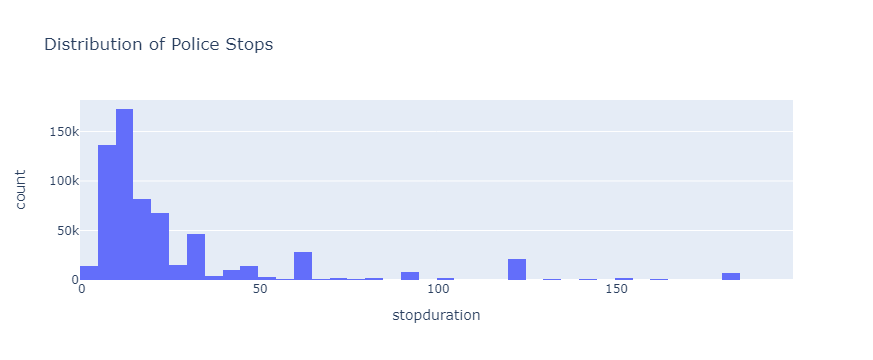

In [46]:
fig = px.histogram(ripa_stops_df_reduced,
                   x="stopduration",
                   nbins=85,
                   #color='perceived_gender'
                   title="Distribution of Police Stops"
                  )
fig.show()

In [56]:
ripa_stops_hr = events_timeseries(ripa_stops_df,'H','date_time')
ripa_stops_q = events_timeseries(ripa_stops_df,'Q','date_time')
ripa_stops_m = events_timeseries(ripa_stops_df,'M','date_time')

#Quarter
ripa_stops_q['year'] = ripa_stops_q['date_time'].dt.year
ripa_stops_q['quarter'] = pd.PeriodIndex(ripa_stops_q.date_time, freq='Q')
ripa_stops_q['Quarter'] = pd.PeriodIndex(ripa_stops_q['quarter'], freq='Q').strftime('%Y-%m')

#Monthly
ripa_stops_m['year'] = ripa_stops_m['date_time'].dt.year
ripa_stops_m['month'] = ripa_stops_m['date_time'].dt.month_name()
ripa_stops_m = ripa_stops_m[ripa_stops_m.year != 2023]
# = ripa_stops_m[ripa_stops_m.year != 2023]


#Hourly
ripa_stops_hr['year'] = ripa_stops_hr['date_time'].dt.year
ripa_stops_hr['hour'] = ripa_stops_hr['date_time'].dt.hour
#time_series_hr = time_series_hr[time_series_hr.year != 2023]
ripa_stops_hr_grby = ripa_stops_hr.groupby(by=["hour","year"]).mean()



In [57]:
ripa_stops_m.head()

,date_time,count,year,month
6,2019-01-31 00:00:00+00:00,14533,2019,January
7,2019-02-28 00:00:00+00:00,12565,2019,February
8,2019-03-31 00:00:00+00:00,16209,2019,March
9,2019-04-30 00:00:00+00:00,15733,2019,April
10,2019-05-31 00:00:00+00:00,16032,2019,May


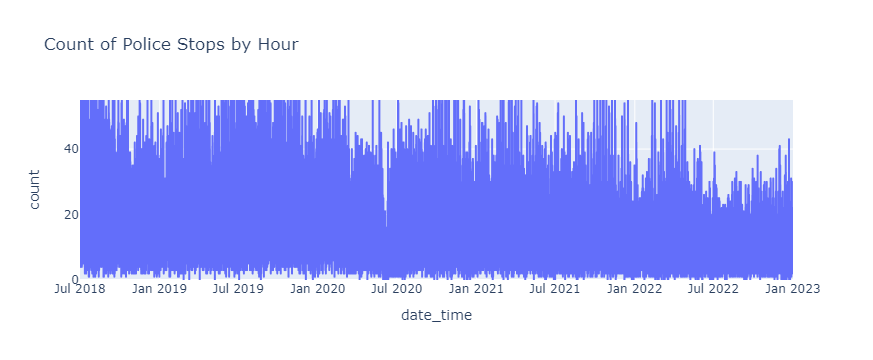

In [58]:
fig = px.line(ripa_stops_hr,
             x='date_time',
             y="count",
             title="Count of Police Stops by Hour"
             )
fig.update_layout(yaxis_range=[0,55])
fig.show()

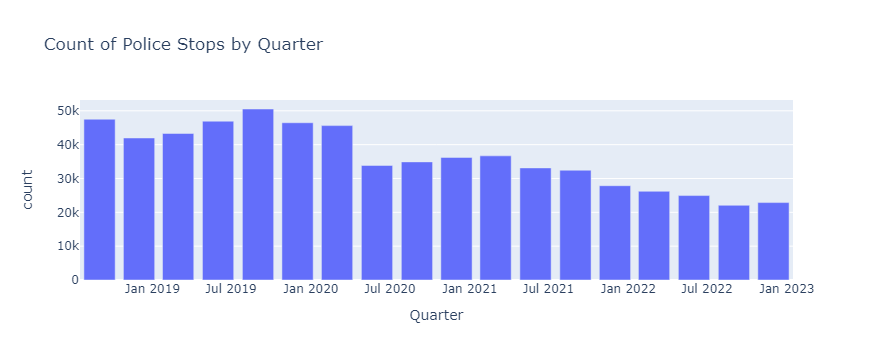

In [51]:
fig = px.bar(ripa_stops_q,
             x='Quarter',
             y="count",
             title="Count of Police Stops by Quarter"
            )
#fig.update_layout(yaxis_range=[100000,160000])
fig.show()

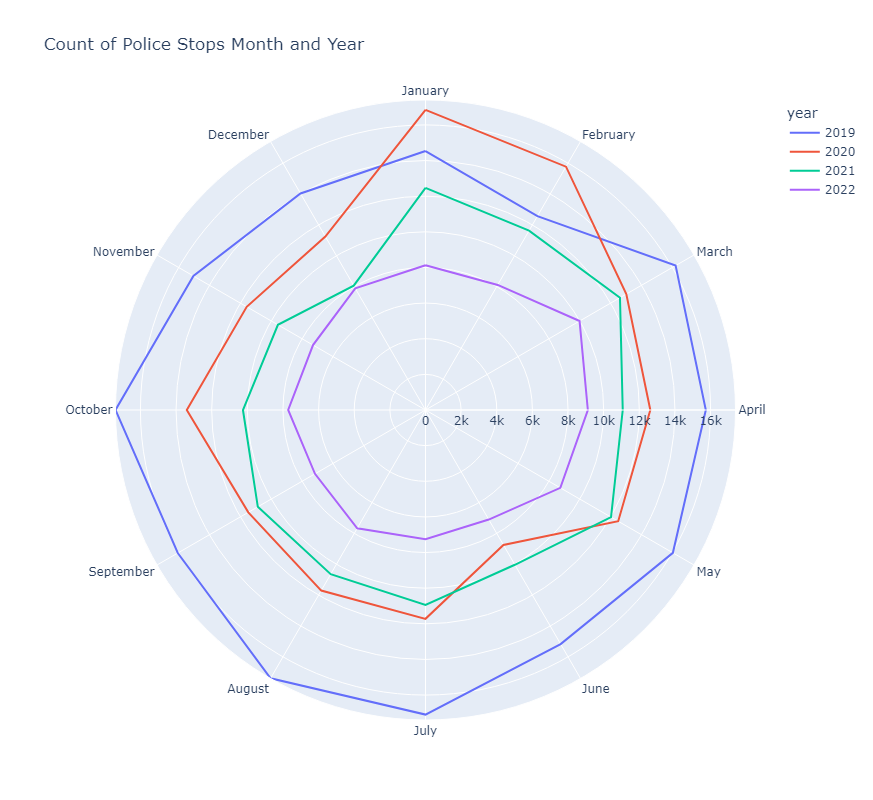

In [52]:
fig = px.line_polar(
    data_frame=ripa_stops_m, 
    r="count", 
    theta="month", 
    color="year",
    #range_r=[30000,55000],
    line_close=True,
    #color_discrete_sequence=px.colors.sequential.Cividis,
    width=800,
    height=800,
    title="Count of Police Stops Month and Year"
    #template = 'ggplot2'
)
fig.show()

In [53]:
#fig = ff.create_table(DQR_Calls)
#fig.layout.DQR_Calls['% Miss.'].cells.format = '.0%'
#fig.show()

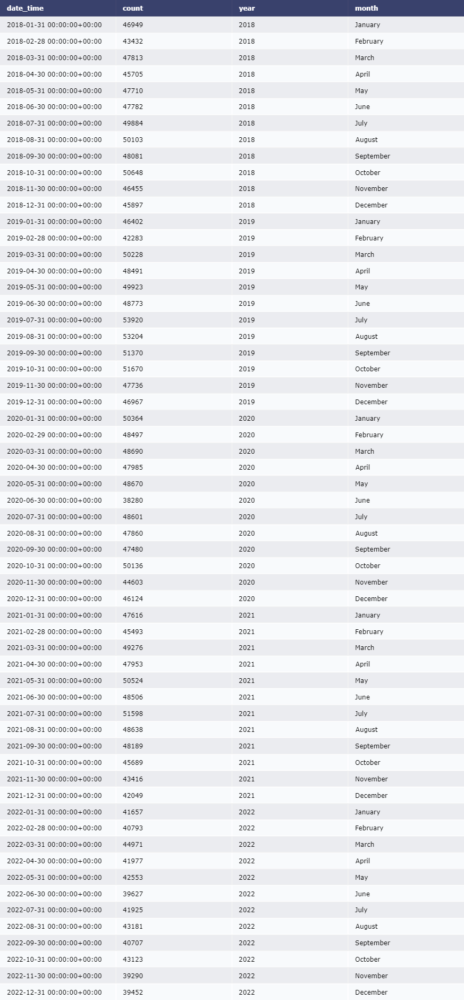

In [54]:
fig = ff.create_table(time_series_complete)
fig.show()

In [55]:
"""fig = ff.create_table(time_series_complete)
fig.update_layout(
autosize=False,
width=500,
height=200,
)
fig.write_image("table_plotly.png", scale=2)
fig.show()"""

'fig = ff.create_table(time_series_complete)\nfig.update_layout(\nautosize=False,\nwidth=500,\nheight=200,\n)\nfig.write_image("table_plotly.png", scale=2)\nfig.show()'

# Police Stop Monthly Time Series 

In [68]:
print(ripa_stops_m.head())
print(ripa_stops_m.dtypes)

                   date_time  count  year     month
6  2019-01-31 00:00:00+00:00  14533  2019   January
7  2019-02-28 00:00:00+00:00  12565  2019  February
8  2019-03-31 00:00:00+00:00  16209  2019     March
9  2019-04-30 00:00:00+00:00  15733  2019     April
10 2019-05-31 00:00:00+00:00  16032  2019       May
date_time    datetime64[ns, UTC]
count                      int64
year                       int64
month                     object
dtype: object


In [86]:
ripa_stops_m.set_index('date_time', inplace = True)
ripa_stops_ts = ripa_stops_m['count']
ripa_stops_ts.head(10)
#print(ripa_stops_ts.dtypes)


date_time
2019-01-31 00:00:00+00:00    14533
2019-02-28 00:00:00+00:00    12565
2019-03-31 00:00:00+00:00    16209
2019-04-30 00:00:00+00:00    15733
2019-05-31 00:00:00+00:00    16032
2019-06-30 00:00:00+00:00    15168
2019-07-31 00:00:00+00:00    17094
2019-08-31 00:00:00+00:00    17391
2019-09-30 00:00:00+00:00    16054
2019-10-31 00:00:00+00:00    17399
Name: count, dtype: int64

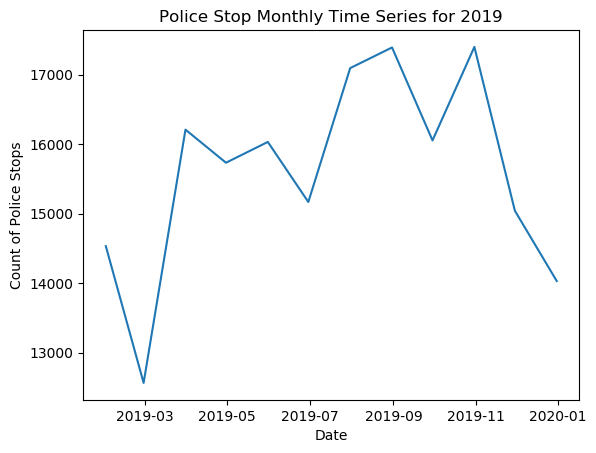

In [102]:

plt.plot(ripa_stops_ts['2019'])
plt.title("Police Stop Monthly Time Series for 2019")
plt.xlabel("Date")
plt.ylabel("Count of Police Stops")
plt.show()

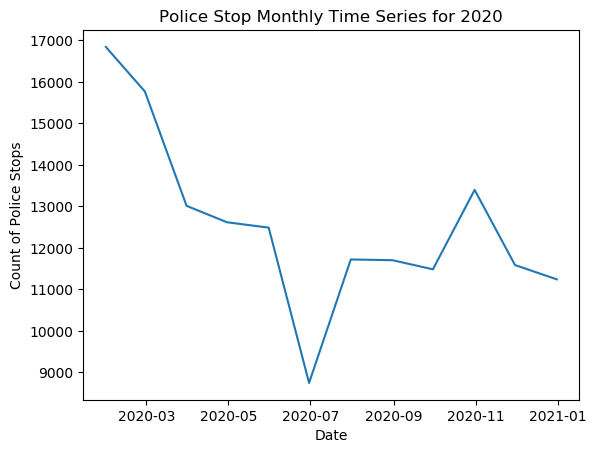

In [103]:
plt.plot(ripa_stops_ts['2020'])
plt.title("Police Stop Monthly Time Series for 2020")
plt.xlabel("Date")
plt.ylabel("Count of Police Stops")
plt.show()

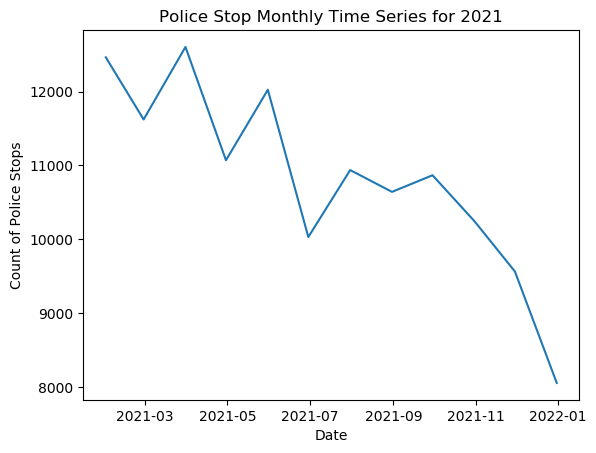

In [104]:
plt.plot(ripa_stops_ts['2021'])
plt.title("Police Stop Monthly Time Series for 2021")
plt.xlabel("Date")
plt.ylabel("Count of Police Stops")
plt.show()

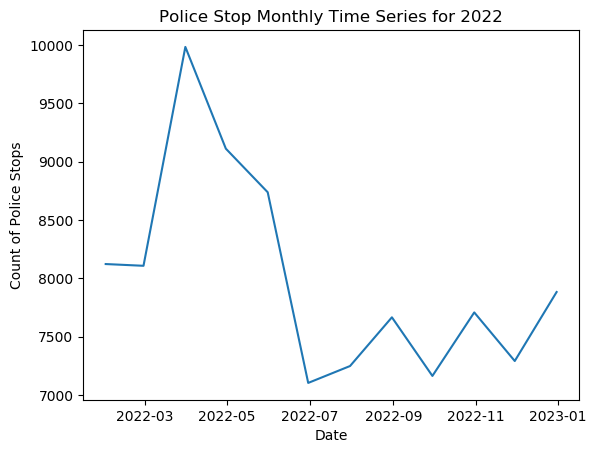

In [105]:
plt.plot(ripa_stops_ts['2022'])
plt.title("Police Stop Monthly Time Series for 2022")
plt.xlabel("Date")
plt.ylabel("Count of Police Stops")
plt.show()

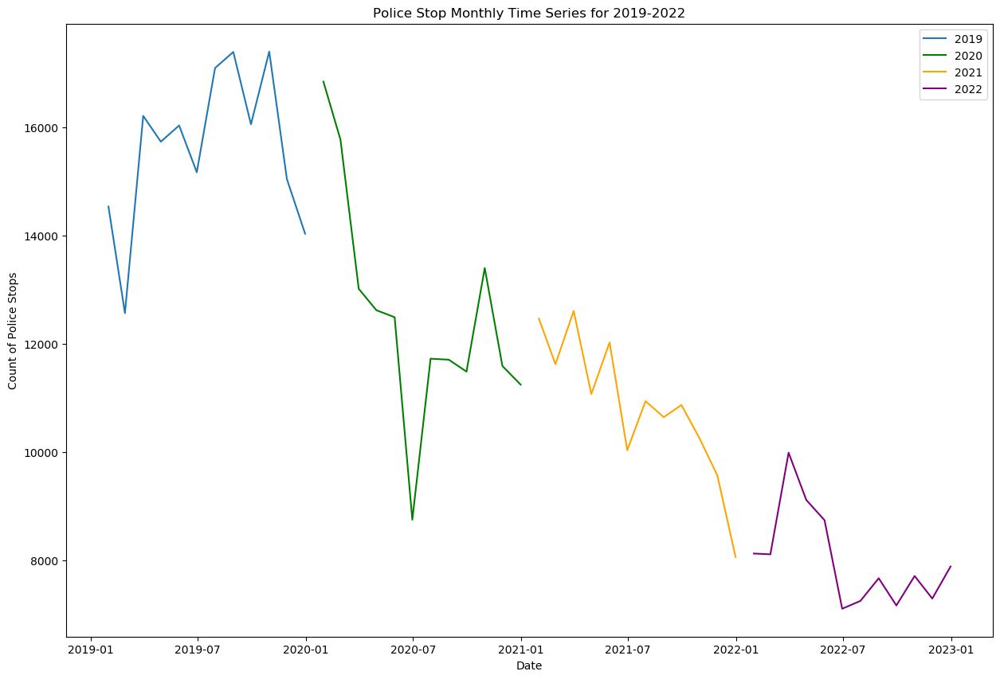

In [108]:
f = plt.figure()
f.set_figwidth(15)
f.set_figheight(10)


plt.plot(ripa_stops_ts['2019'])
plt.plot(ripa_stops_ts['2020'], color='green')
plt.plot(ripa_stops_ts['2021'], color='orange')
plt.plot(ripa_stops_ts['2022'], color='purple')
plt.title("Police Stop Monthly Time Series for 2019-2022")
plt.xlabel("Date")
plt.ylabel("Count of Police Stops")
plt.legend(['2019', '2020', '2021', '2022'])
plt.show()

# Time Series: Trend, Seasonality, and Residuals

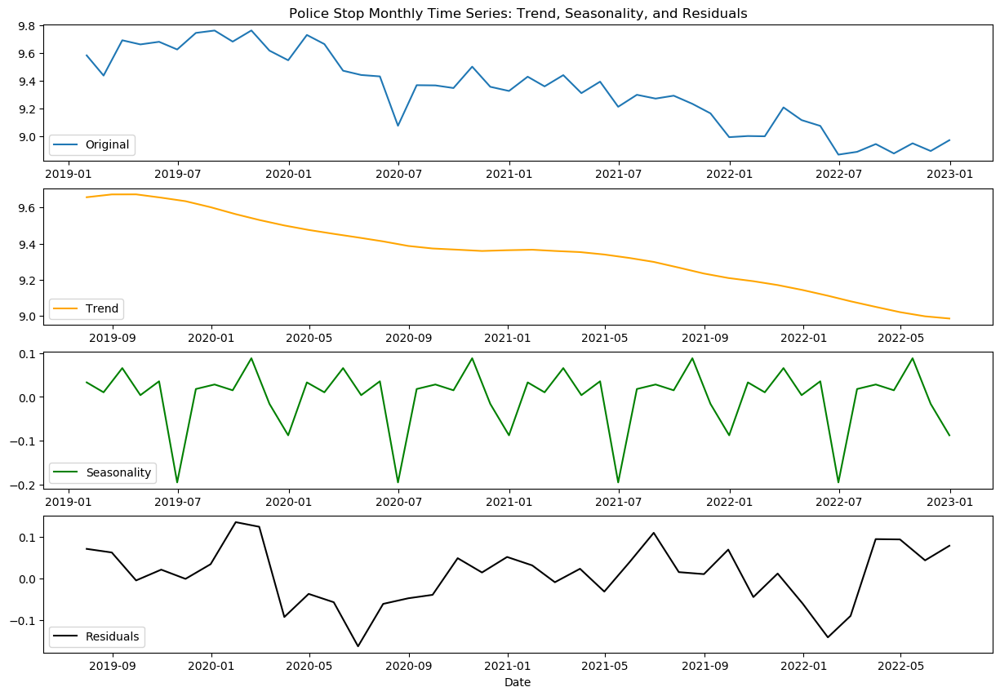

In [137]:
ripa_stops_log = np.log(ripa_stops_ts)

decom_ripa = seasonal_decompose(ripa_stops_log)

trend_ripa_stops = decom_ripa.trend
season_ripa_stops = decom_ripa.seasonal
resid_ripa_stops = decom_ripa.resid

f = plt.figure()
f.set_figwidth(15)
f.set_figheight(10)


plt.xlabel("Date")
plt.subplot(411)
plt.plot(ripa_stops_log)
plt.title("Police Stop Monthly Time Series: Trend, Seasonality, and Residuals")
plt.legend(["Original"], loc = "lower left")
plt.subplot(412)
plt.plot(trend_ripa_stops, color='orange')
plt.legend(["Trend"], loc = "lower left")
plt.subplot(413)
plt.plot(season_ripa_stops, color='green')
plt.legend(["Seasonality"], loc = "lower left")
plt.subplot(414)
plt.plot(resid_ripa_stops, color='black')
plt.legend(["Residuals"], loc = "lower left")
plt.xlabel("Date")
plt.show()



## Removing Trend and Seasonality

In [138]:

diff_ripa = ripa_stops_log - ripa_stops_log.shift()
diff_ripa.dropna(inplace = True)

